Epoch 1/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 1: Loss=0.4701


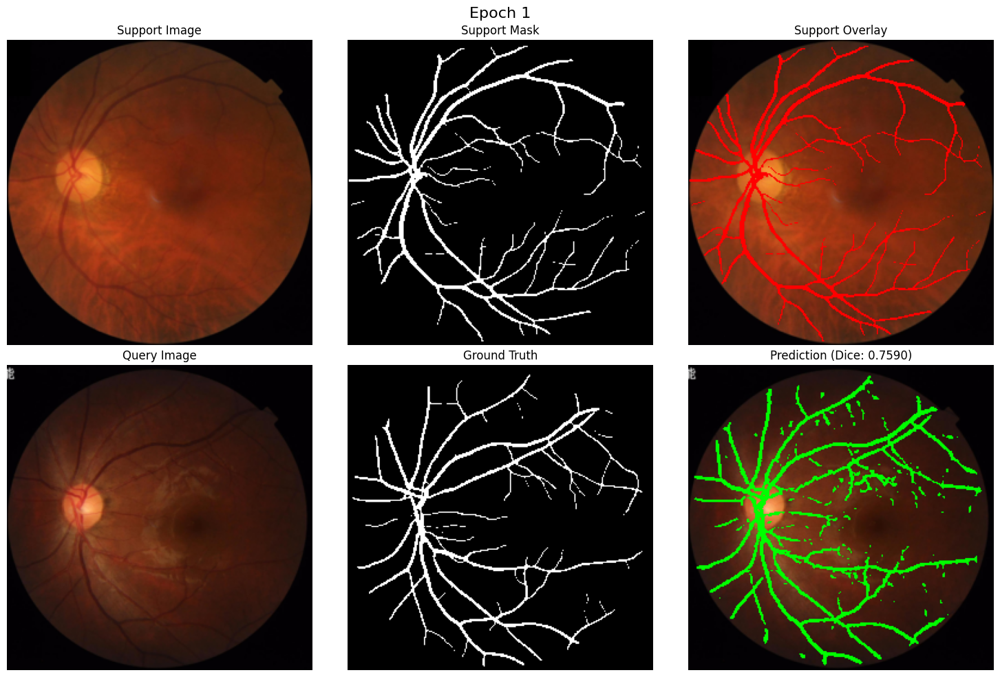

Epoch 2/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 2: Loss=0.3520


Epoch 3/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 3: Loss=0.2748


Epoch 4/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 4: Loss=0.2126


Epoch 5/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 5: Loss=0.1622


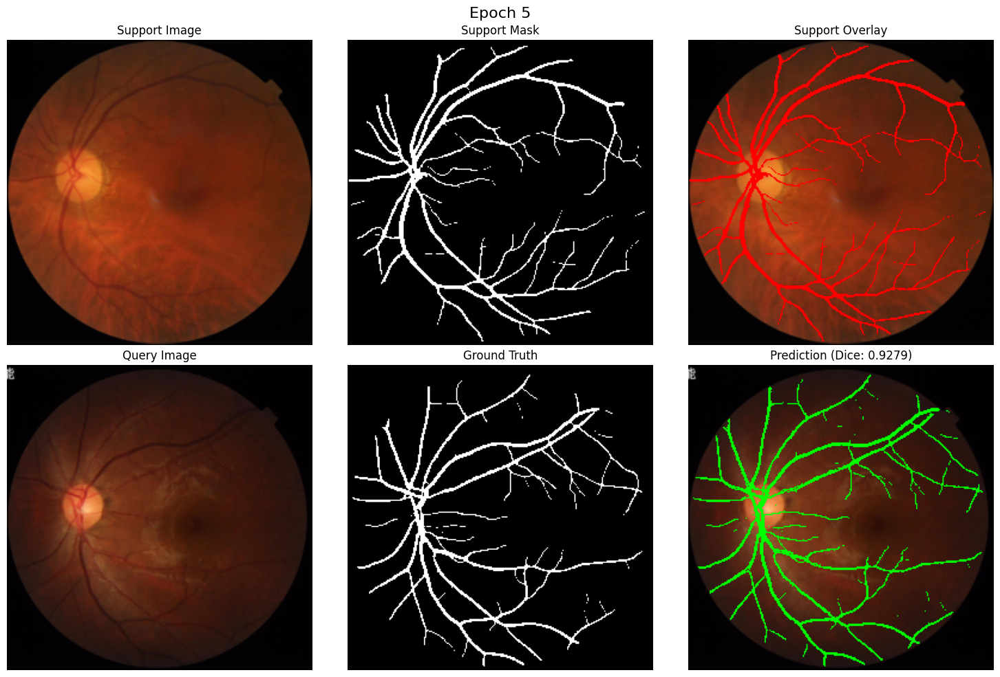

Epoch 6/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 6: Loss=0.1220


Epoch 7/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 7: Loss=0.0971


Epoch 8/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 8: Loss=0.0791


Epoch 9/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 9: Loss=0.0638


Epoch 10/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 10: Loss=0.0498


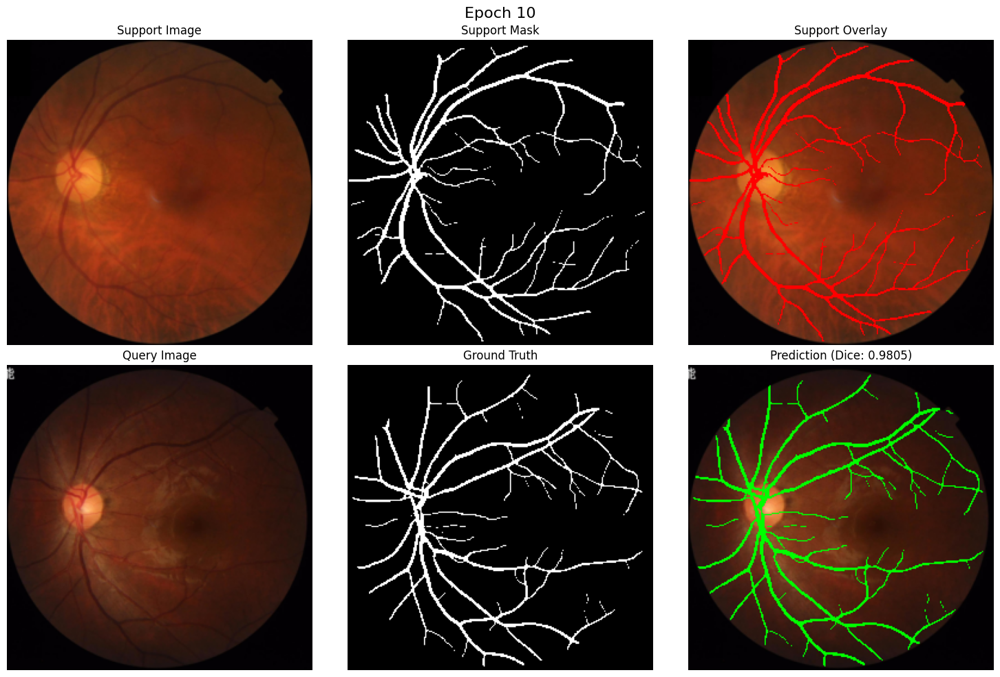

Saved checkpoint at checkpoint_epoch_10.pth


Epoch 11/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 11: Loss=0.0437


Epoch 12/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 12: Loss=0.0361


Epoch 13/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 13: Loss=0.0318


Epoch 14/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 14: Loss=0.0271


Epoch 15/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 15: Loss=0.0241


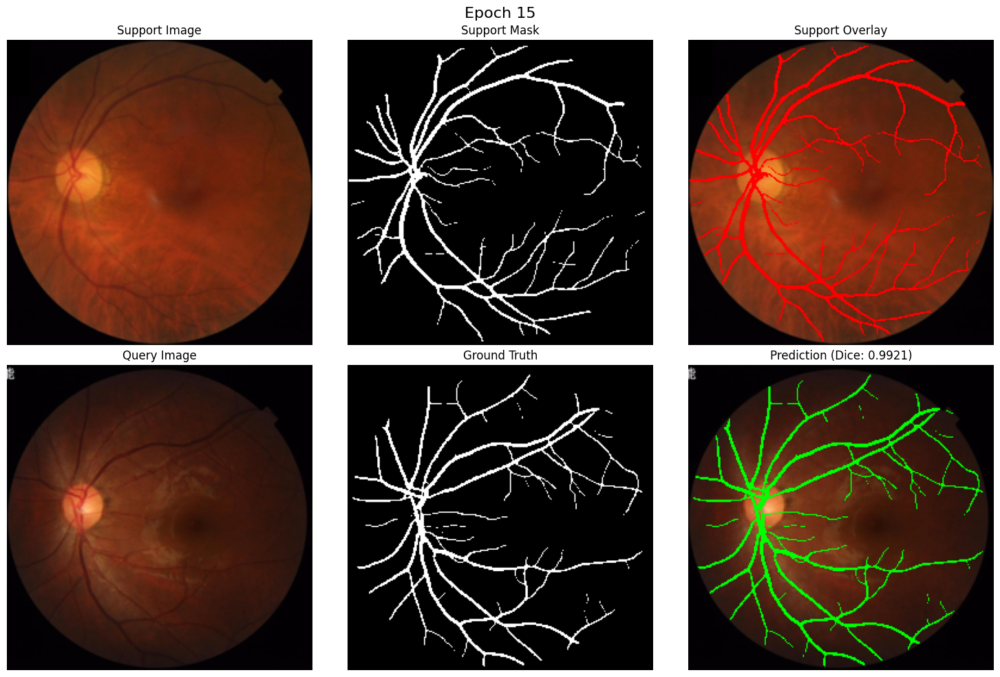

Epoch 16/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 16: Loss=0.0206


Epoch 17/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 17: Loss=0.0173


Epoch 18/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 18: Loss=0.0161


Epoch 19/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 19: Loss=0.0147


Epoch 20/20:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch 20: Loss=0.0127


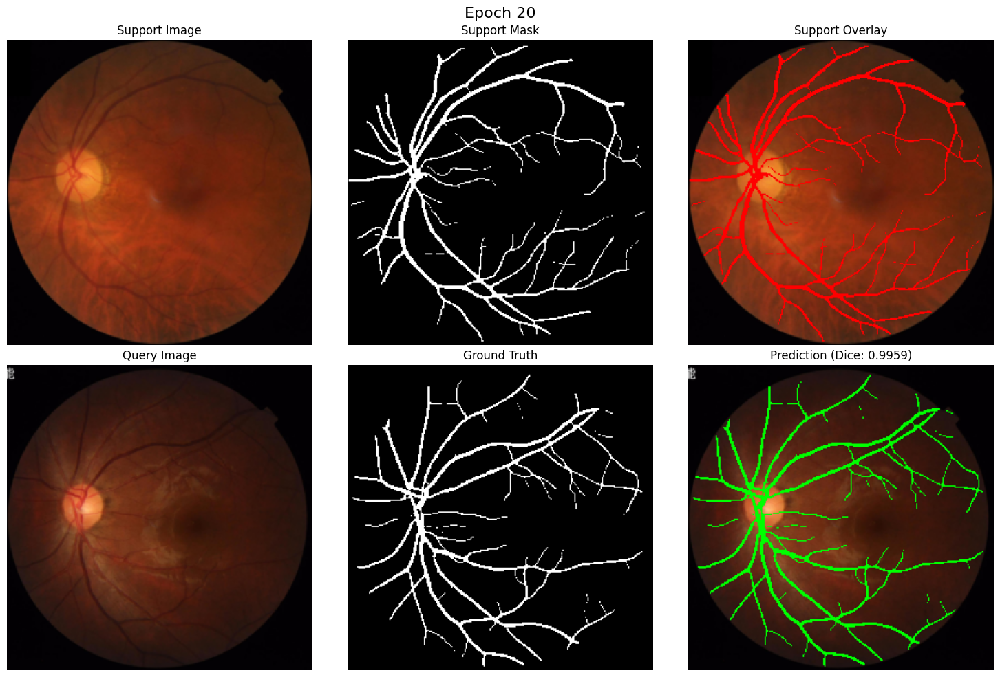

Saved checkpoint at checkpoint_epoch_20.pth


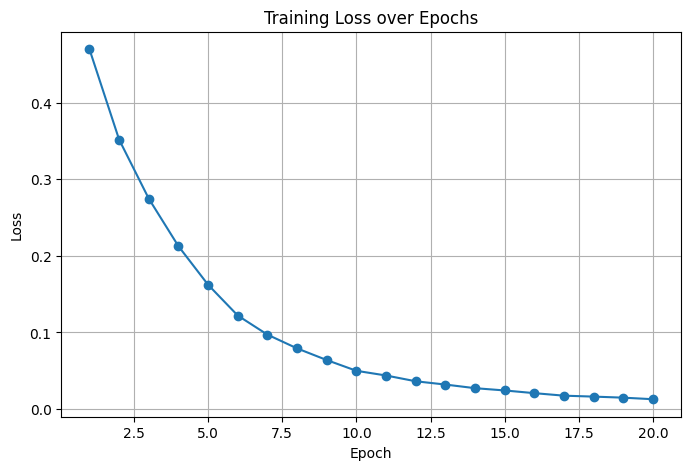

In [1]:
import os
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

# -----------------------------
# 1. Model Definitions
# -----------------------------
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Up, self).__init__()
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = F.pad(x1, (diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2))
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class AttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionBlock, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1),
            nn.BatchNorm2d(F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1),
            nn.BatchNorm2d(F_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        if g.shape[2:] != x.shape[2:]:
            g = F.interpolate(g, size=x.shape[2:], mode='bilinear', align_corners=True)
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi

class ProtoUNet(nn.Module):
    def __init__(self, n_channels=3, n_classes=1, num_prototypes=5):
        super(ProtoUNet, self).__init__()
        self.num_prototypes = num_prototypes
        self.features = [64, 128, 256, 512]
        # Encoder
        self.inc = DoubleConv(n_channels, self.features[0])
        self.down1 = Down(self.features[0], self.features[1])
        self.down2 = Down(self.features[1], self.features[2])
        self.down3 = Down(self.features[2], self.features[3])
        # Bottleneck
        self.bottleneck = DoubleConv(self.features[3], self.features[3])
        # Attention blocks
        self.att3 = AttentionBlock(self.features[3], self.features[2], self.features[1])
        self.att2 = AttentionBlock(self.features[2], self.features[1], self.features[0])
        self.att1 = AttentionBlock(self.features[1], self.features[0], self.features[0]//2)
        # Decoder
        self.up3 = Up(self.features[3] + self.features[2], self.features[2])
        self.up2 = Up(self.features[2] + self.features[1], self.features[1])
        self.up1 = Up(self.features[1] + self.features[0], self.features[0])
        self.outc = nn.Conv2d(self.features[0], n_classes, kernel_size=1)
        # Prototype layers
        self.proto_layers = nn.ModuleList([
            nn.ModuleList([nn.Conv2d(feat, feat, kernel_size=1) for _ in range(num_prototypes)])
            for feat in self.features
        ])

    def forward_encoder(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x4 = self.bottleneck(x4)
        return [x1, x2, x3, x4]

    def compute_prototypes(self, features, mask):
        all_protos = []
        for lvl, feat in enumerate(features):
            lvl_protos = []
            msk_resized = F.interpolate(mask, size=feat.shape[2:], mode='nearest')
            for p in range(self.num_prototypes):
                if p == 0:
                    proto_mask = msk_resized
                elif p in [1, 2]:
                    kernel = torch.ones(3, 3, device=mask.device)
                    padded = F.pad(msk_resized, (1, 1, 1, 1))
                    conv = F.conv2d(padded, kernel.view(1, 1, 3, 3))
                    if p == 1:
                        proto_mask = ((conv == 1) & (msk_resized == 1)).float()
                    else:
                        proto_mask = ((conv >= 3) & (msk_resized == 1)).float()
                elif p == 3:
                    eroded = F.max_pool2d(msk_resized, 3, 1, padding=1) < 1
                    dilated = F.max_pool2d(-msk_resized + 1, 3, 1, padding=1) < 1
                    proto_mask = (dilated & ~eroded).float()
                else:
                    kernel = torch.ones(5, 5, device=mask.device)
                    padded = F.pad(msk_resized, (2, 2, 2, 2))
                    thick = F.conv2d(padded, kernel.view(1, 1, 5, 5)) >= 15
                    proto_mask = (thick.float() * msk_resized)
                masked = feat * proto_mask
                sum_mask = proto_mask.sum(dim=(2, 3), keepdim=True) + 1e-8
                proto = masked.sum(dim=(2, 3), keepdim=True) / sum_mask
                proto = self.proto_layers[lvl][p](proto)
                lvl_protos.append(proto)
            all_protos.append(lvl_protos)
        return all_protos

    def forward(self, support_img, support_mask, query_img):
        sup_feats = self.forward_encoder(support_img)
        qry_feats = self.forward_encoder(query_img)
        protos = self.compute_prototypes(sup_feats, support_mask)
        guided = []
        for lvl, qf in enumerate(qry_feats):
            guidance = torch.zeros_like(qf)
            for proto in protos[lvl]:
                p = proto.mean(0, True).expand_as(qf)
                guidance += 0.1 * p
            guided.append(qf + guidance)
        return self.decode(guided)

    def decode(self, feats):
        x1, x2, x3, x4 = feats
        x3_att = self.att3(x4, x3)
        x = self.up3(x4, x3_att)
        x2_att = self.att2(x, x2)
        x = self.up2(x, x2_att)
        x1_att = self.att1(x, x1)
        x = self.up1(x, x1_att)
        return self.outc(x)

# -----------------------------
# 2. Loss Definition
# -----------------------------
class VesselSegLoss(nn.Module):
    def __init__(self, alpha=0.5, beta=0.3, gamma=0.2):
        super(VesselSegLoss, self).__init__()
        self.alpha, self.beta, self.gamma = alpha, beta, gamma

    def forward(self, pred, target):
        pred_sig = torch.sigmoid(pred)
        smooth = 1e-6
        inter = (pred_sig * target).sum(dim=(2, 3))
        dice_loss = 1 - ((2 * inter + smooth) / (pred_sig.sum((2, 3)) + target.sum((2, 3)) + smooth))
        dice_loss = dice_loss.mean()
        bce_loss = F.binary_cross_entropy_with_logits(pred, target)
        kernel = torch.ones(1, 1, 3, 3, device=pred.device)
        dilated_target = F.conv2d(F.pad(target, (1, 1, 1, 1), mode='replicate'), kernel)
        dilated_target = (dilated_target > 0).float()
        topology_loss = F.mse_loss(pred_sig, pred_sig * dilated_target)
        return self.alpha * dice_loss + self.beta * bce_loss + self.gamma * topology_loss, dice_loss, bce_loss, topology_loss

# -----------------------------
# 3. Visualization Function
# -----------------------------
def visualize_results(sup_img, sup_mask, qry_img, qry_mask, pred_logits, epoch=None):
    """
    sup_img:  C×H×W  or  1×C×H×W  
    sup_mask: 1×H×W  or  1×1×H×W  
    similarly for qry_img, qry_mask; 
    pred_logits: 1×1×H×W logits from your model
    """

    # Squeeze batch dimension if present
    if sup_img.ndim == 4:  sup_img  = sup_img[0]
    if sup_mask.ndim == 4: sup_mask = sup_mask[0]
    if qry_img.ndim == 4:  qry_img  = qry_img[0]
    if qry_mask.ndim == 4: qry_mask = qry_mask[0]
    if pred_logits.ndim == 4: pred_logits = pred_logits[0]

    # Move to CPU & numpy
    sup_img_np   = sup_img.cpu().permute(1, 2, 0).numpy()
    sup_mask_np  = sup_mask.cpu().squeeze().numpy()
    qry_img_np   = qry_img.cpu().permute(1, 2, 0).numpy()
    qry_mask_np  = qry_mask.cpu().squeeze().numpy()
    pred_np      = torch.sigmoid(pred_logits).cpu().squeeze().numpy()

    # Compute Dice
    pred_bin = (pred_np > 0.5).astype(np.float32)
    intersection = (pred_bin * qry_mask_np).sum()
    dice_score = (2 * intersection) / (pred_bin.sum() + qry_mask_np.sum() + 1e-6)

    # Create overlays
    sup_overlay = sup_img_np.copy()
    sup_overlay[sup_mask_np > 0.5] = [1, 0, 0]       # red

    qry_overlay = qry_img_np.copy()
    qry_overlay[pred_np > 0.5]     = [0, 1, 0]       # green

    # Plot
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    axs[0, 0].imshow(sup_img_np);      axs[0, 0].set_title("Support Image"); axs[0, 0].axis('off')
    axs[0, 1].imshow(sup_mask_np, cmap='gray'); axs[0, 1].set_title("Support Mask");  axs[0, 1].axis('off')
    axs[0, 2].imshow(sup_overlay);     axs[0, 2].set_title("Support Overlay"); axs[0, 2].axis('off')

    axs[1, 0].imshow(qry_img_np);      axs[1, 0].set_title("Query Image");   axs[1, 0].axis('off')
    axs[1, 1].imshow(qry_mask_np, cmap='gray'); axs[1, 1].set_title("Ground Truth"); axs[1, 1].axis('off')
    axs[1, 2].imshow(qry_overlay);     axs[1, 2].set_title(f"Prediction (Dice: {dice_score:.4f})"); axs[1, 2].axis('off')

    if epoch is not None:
        fig.suptitle(f"Epoch {epoch}", fontsize=16)

    plt.tight_layout()
    plt.show()


# -----------------------------
# 4. Episodic Dataset & Loader
# -----------------------------
class EpisodicBloodVesselDataset(Dataset):
    def __init__(self, roots, transform=None, K=3, Q=5, episodes=200):
        self.paths, self.msks = [], []
        for root in roots:
            for cond in ['glaucoma', 'normal']:
                idr = os.path.join(root, 'images', cond)
                mdr = os.path.join(root, 'masks', cond)
                if os.path.isdir(idr) and os.path.isdir(mdr):
                    for f in os.listdir(idr):
                        if f.endswith('.png'):
                            self.paths.append(os.path.join(idr, f))
                            self.msks.append(os.path.join(mdr, f))
        self.transform, self.K, self.Q, self.episodes = transform, K, Q, episodes

    def __len__(self):
        return self.episodes

    def __getitem__(self, idx):
        idxs = random.sample(range(len(self.paths)), self.K + self.Q)
        sup_idx, qry_idx = idxs[:self.K], idxs[self.K:]
        def load_pair(i):
            img = Image.open(self.paths[i]).convert('RGB')
            msk = Image.open(self.msks[i]).convert('L')
            if self.transform:
                img = self.transform(img)
                msk = self.transform(msk); msk = (msk > 0.5).float()
            else:
                img = transforms.ToTensor()(img)
                msk = (transforms.ToTensor()(msk) > 0.5).float()
            return img, msk
        support = [load_pair(i) for i in sup_idx]
        query = [load_pair(i) for i in qry_idx]
        s_i, s_m = zip(*support); q_i, q_m = zip(*query)
        return torch.stack(s_i), torch.stack(s_m), torch.stack(q_i), torch.stack(q_m)

transform = transforms.Compose([transforms.Resize((256, 256)), transforms.ToTensor()])
support_path = '/kaggle/input/blood-vessel-support-set-fives/blood_vessel_support_set'
query_path   = '/kaggle/input/blood-vessel-query-set/blood_vessel_query_set'
train_ds = EpisodicBloodVesselDataset([support_path, query_path], transform, 3, 5, 200)
train_loader = DataLoader(train_ds, batch_size=1, shuffle=True, num_workers=0, pin_memory=True)

# -----------------------------
# 5. Meta-Training Loop
# -----------------------------
import matplotlib.pyplot as plt

def train_few_shot(model, criterion, optimizer, scheduler, loader, device, epochs=20):
    scaler = torch.amp.GradScaler("cuda")
    

    # For consistent visualization
    data_iter = iter(loader)
    viz_si, viz_sm, viz_qi, viz_qm = next(data_iter)

    loss_values = []

    for ep in range(1, epochs + 1):
        model.train()
        total_loss = 0.0
        loop = tqdm(loader, desc=f'Epoch {ep}/{epochs}', leave=False)

        for s_i, s_m, q_i, q_m in loop:
            s_i = s_i.squeeze(0).to(device, memory_format=torch.channels_last)
            s_m = s_m.squeeze(0).to(device)
            q_i = q_i.squeeze(0).to(device, memory_format=torch.channels_last)
            q_m = q_m.squeeze(0).to(device)

            optimizer.zero_grad()

            with torch.amp.autocast("cuda"):
                pred = model(s_i, s_m, q_i)
                loss, _, _, _ = criterion(pred, q_m)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            total_loss += loss.item()
            loop.set_postfix(loss=total_loss / (loop.n + 1))

        avg_loss = total_loss / len(loader)
        loss_values.append(avg_loss)
        scheduler.step()
        print(f"Epoch {ep}: Loss={avg_loss:.4f}")

        # Visualization every 5 epochs
        if ep % 5 == 0 or ep==1:
            model.eval()
            with torch.no_grad():
                pred_v = model(
                    viz_si.squeeze(0).to(device, memory_format=torch.channels_last),
                    viz_sm.squeeze(0).to(device),
                    viz_qi.squeeze(0).to(device, memory_format=torch.channels_last)
                )
                # Instead of squeezing, use indexing to get the first element
            visualize_results(
                viz_si[0], viz_sm[0],
                viz_qi[0], viz_qm[0],
                pred_v[0] if pred_v.dim() > 3 else pred_v,
                epoch=ep
            )

            model.train()

        # Save model checkpoint every 10 epochs
        if ep % 10 == 0:
            ckpt_path = f"checkpoint_epoch_{ep}.pth"
            torch.save(model.state_dict(), ckpt_path)
            print(f"Saved checkpoint at {ckpt_path}")

    # Plot loss vs epoch after training
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, epochs + 1), loss_values, marker='o')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss over Epochs')
    plt.grid(True)
    plt.show()

    return model

# -----------------------------
# 6. Initialize & Run
# -----------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = ProtoUNet(3, 1, 5).to(device)
criterion = VesselSegLoss(0.5, 0.3, 0.2)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=300, eta_min=1e-6)
model = train_few_shot(model, criterion, optimizer, scheduler, train_loader, device, epochs=20)


<ipython-input-2-ce0933290d2a>:72: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('/kaggle/working/checkpoint_epoch_10.pth', map_location=device)


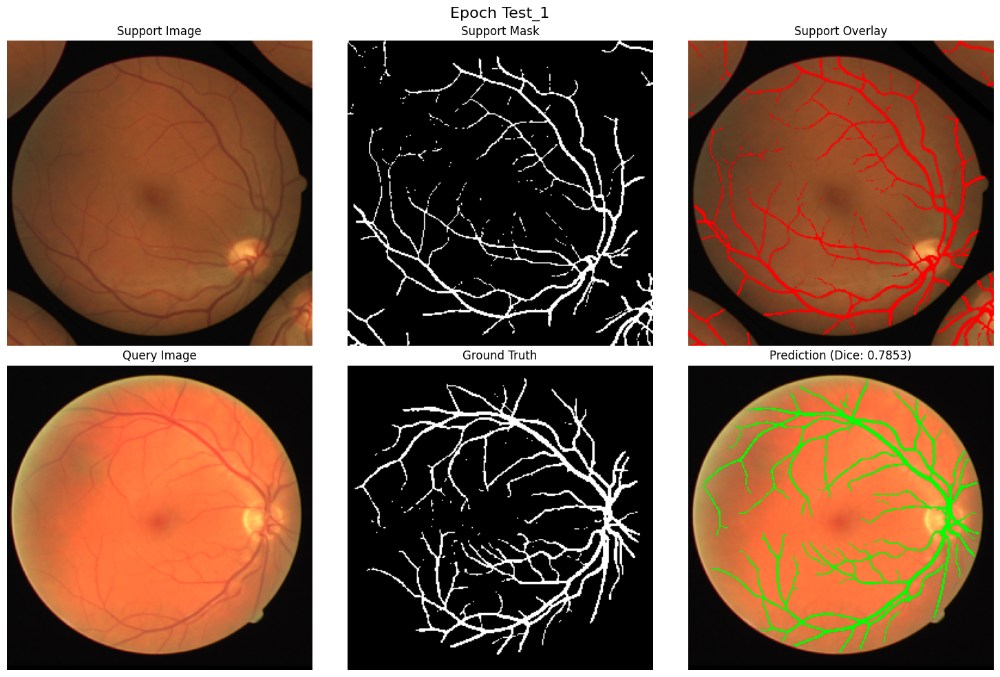

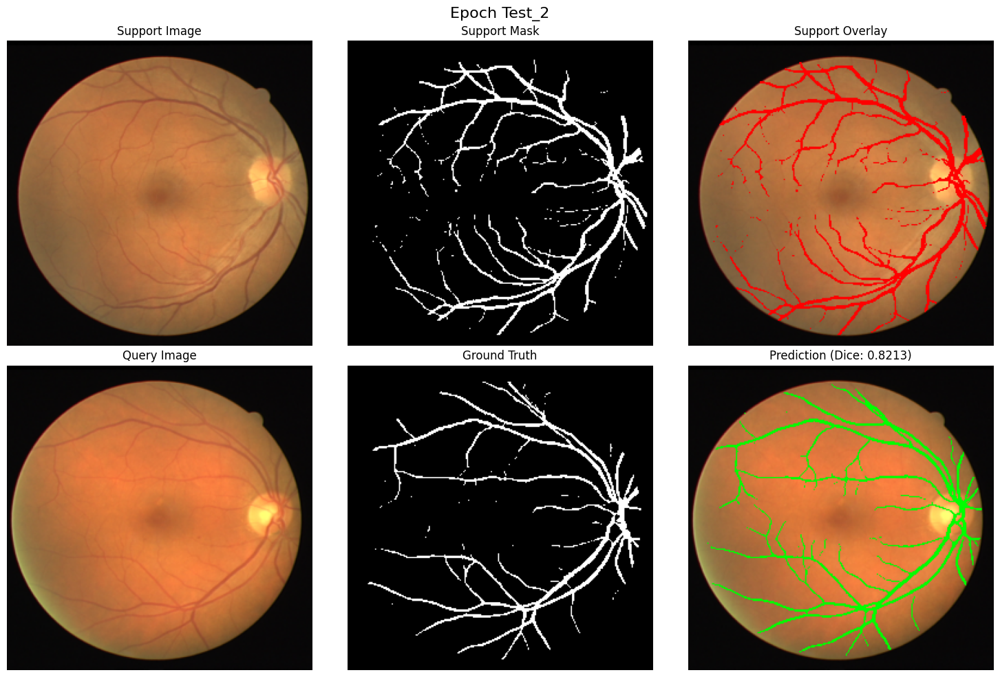

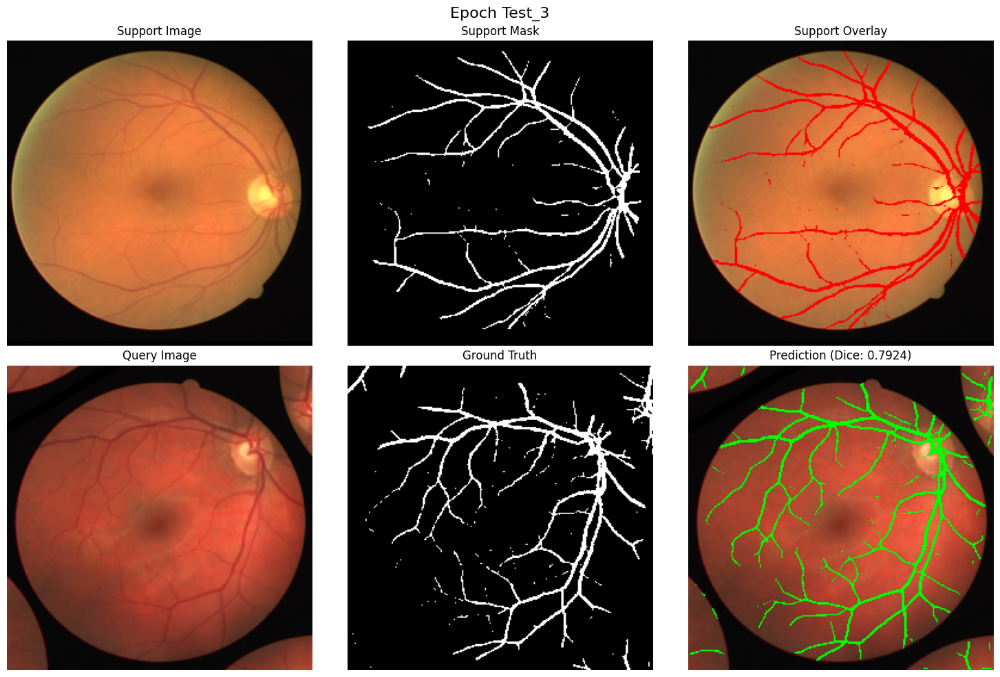

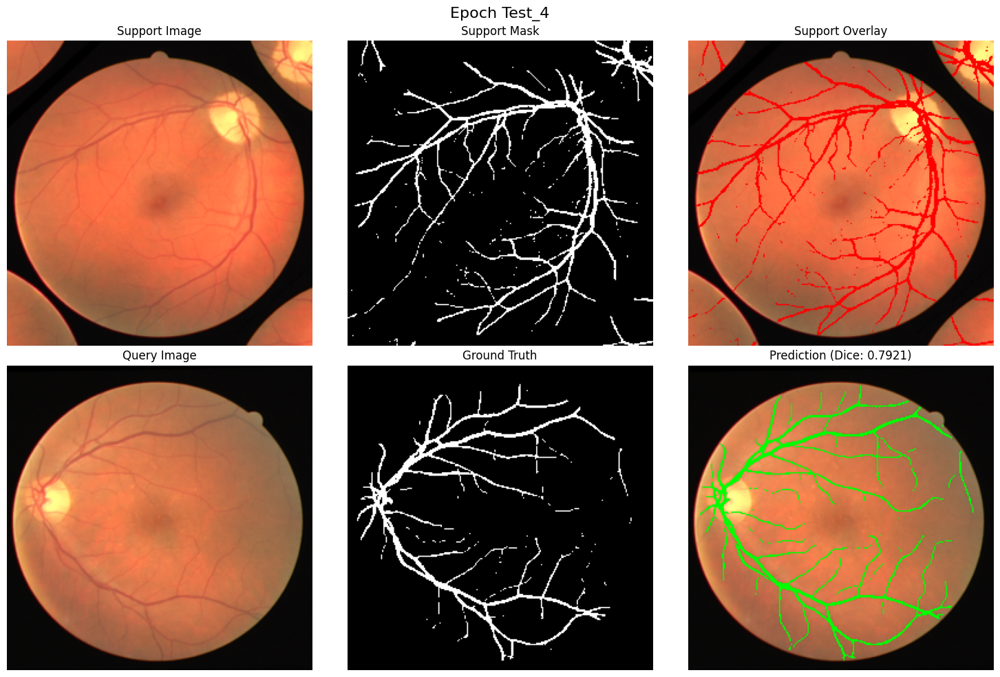

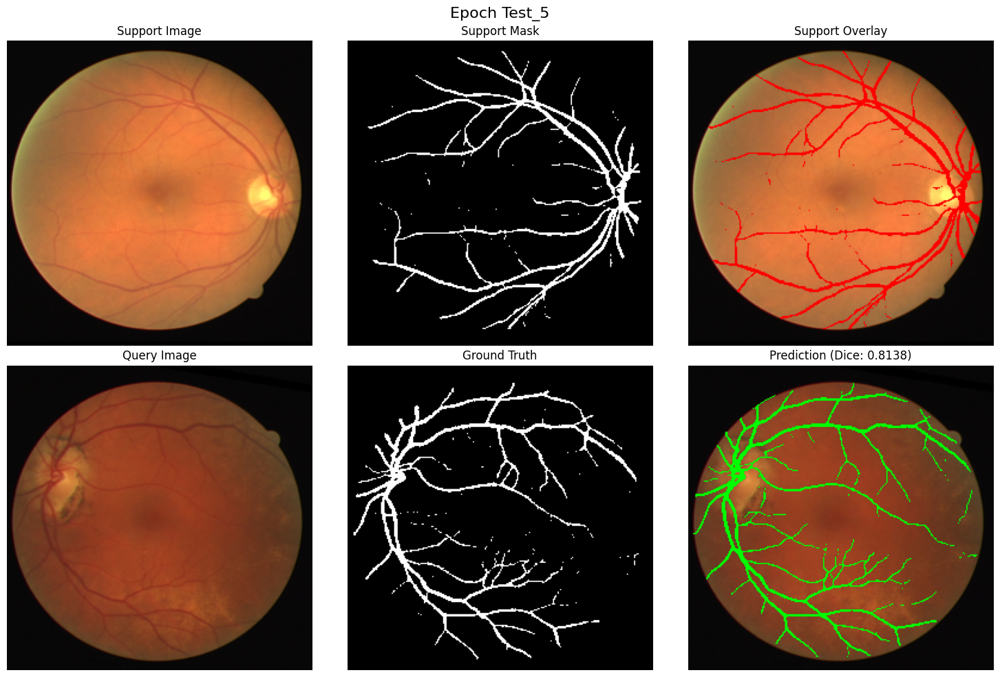

...

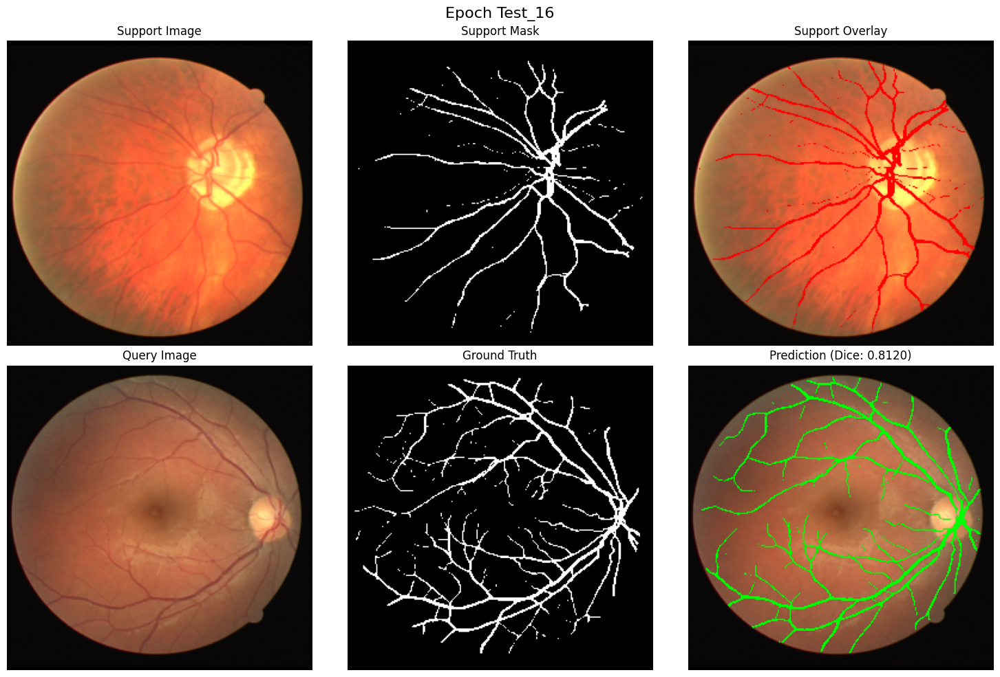

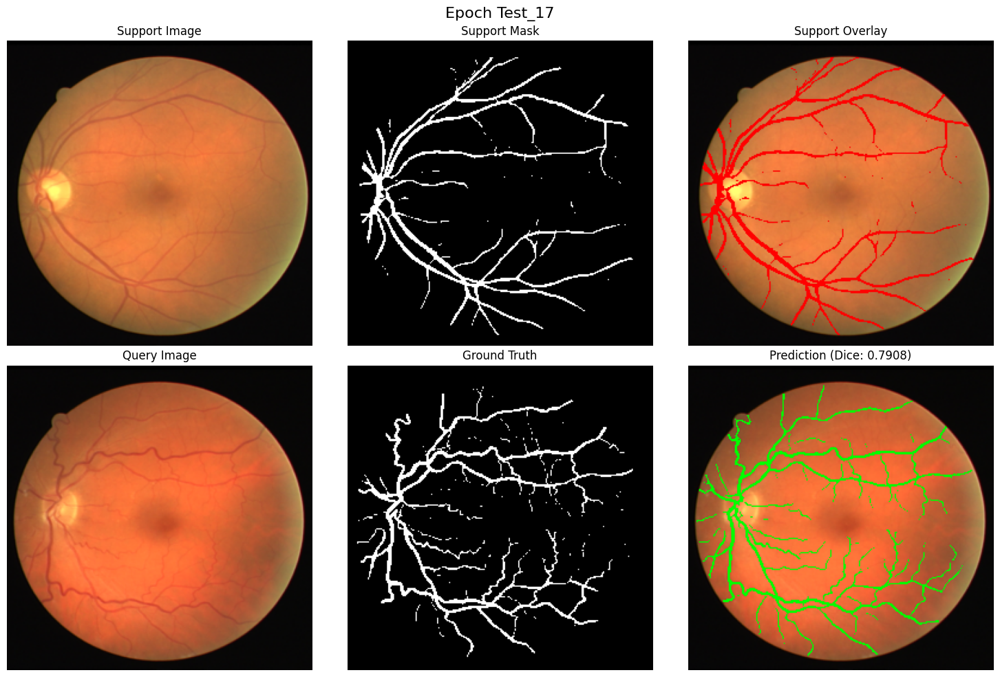

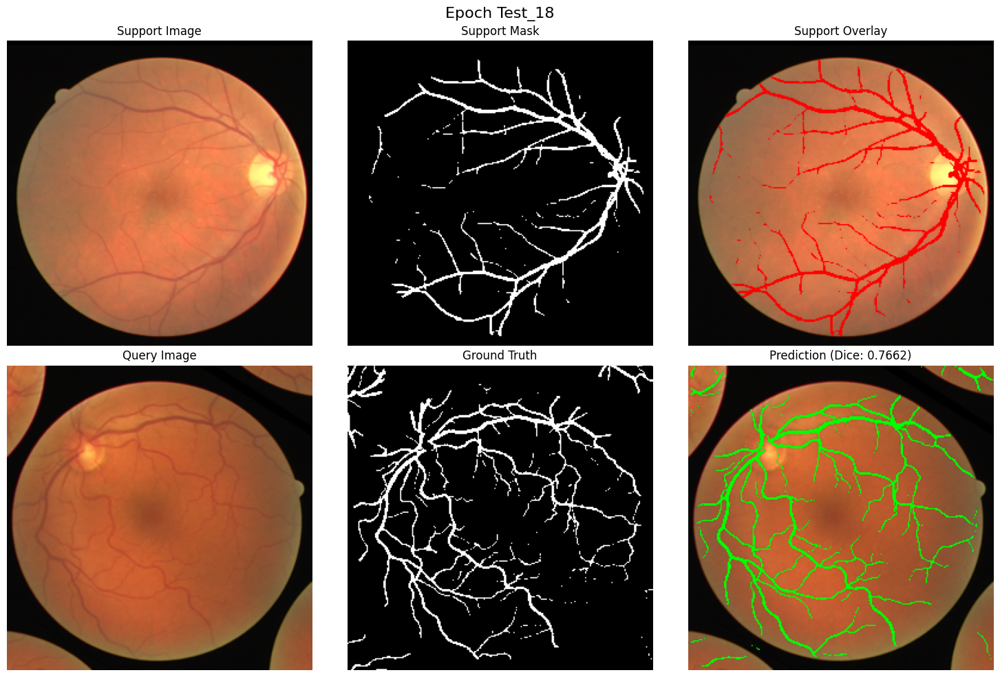

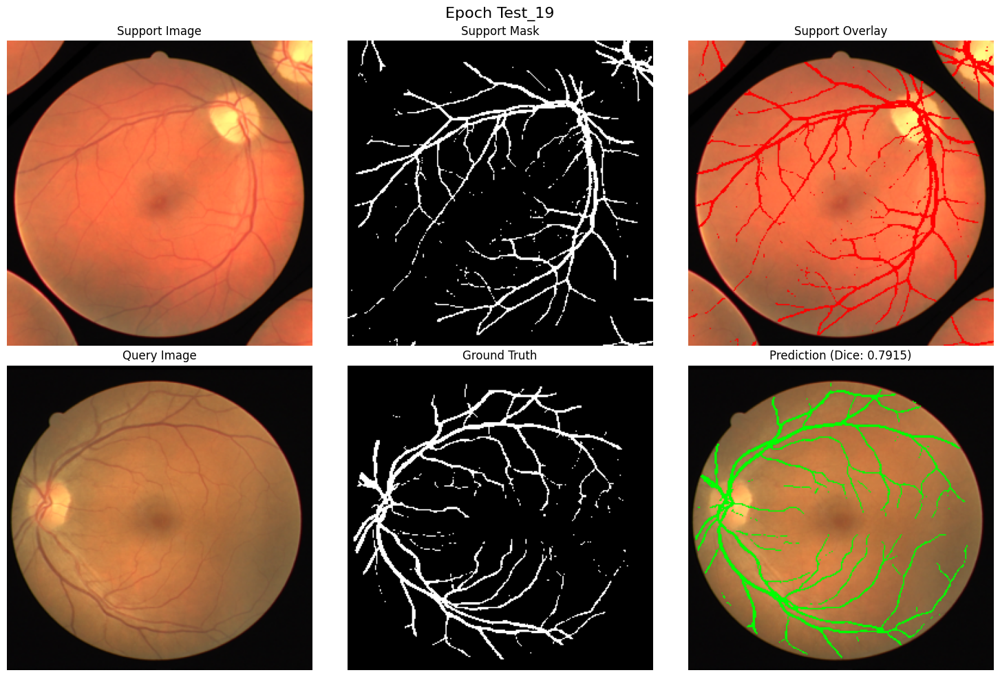

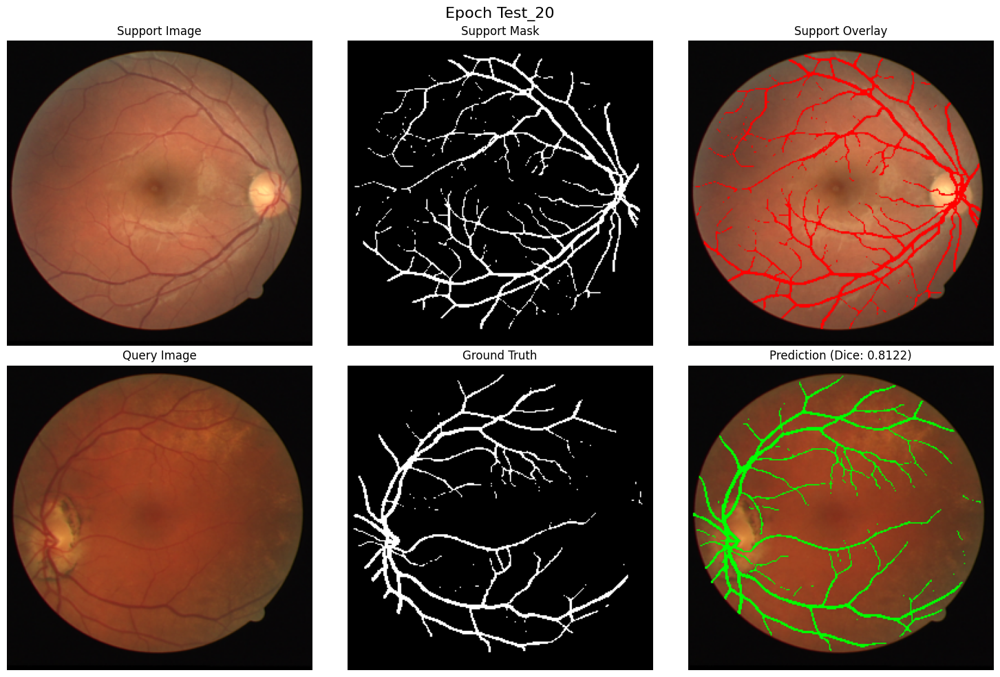

Mean IoU per class:
  Class 0 (Background): 0.9659
  Class 1 (Vessel):      0.6416
Mean Dice per class:
  Class 0 (Background): 0.9826
  Class 1 (Vessel):      0.7817


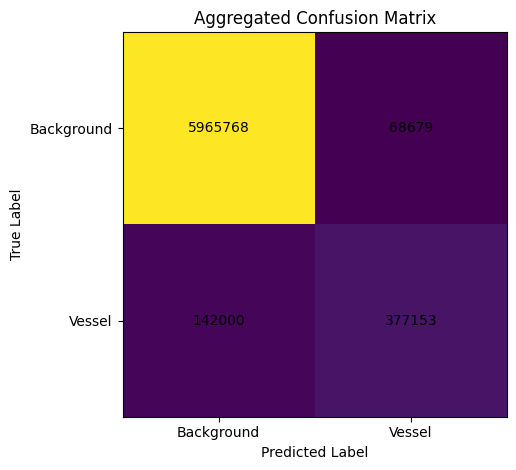

In [2]:
import os
import random
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Ensure ProtoUNet and visualize_results are defined/imported above

class RetinalVesselEpisodicDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, K=3, Q=5, episodes=20):
        self.image_paths, self.mask_paths = [], []
        for fn in os.listdir(image_dir):
            if fn.lower().endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(image_dir, fn)
                mask_path = os.path.join(mask_dir, fn)
                if os.path.isfile(mask_path):
                    self.image_paths.append(img_path)
                    self.mask_paths.append(mask_path)
        assert len(self.image_paths) >= K + Q, (
            f"Not enough samples ({len(self.image_paths)}) for K={K}+Q={Q}"
        )
        self.transform = transform
        self.K = K
        self.Q = Q
        self.episodes = episodes

    def __len__(self):
        return self.episodes

    def __getitem__(self, idx):
        total = len(self.image_paths)
        chosen = random.sample(range(total), self.K + self.Q)
        sup_idxs, qry_idxs = chosen[:self.K], chosen[self.K:]

        def load_pair(i):
            img = Image.open(self.image_paths[i]).convert('RGB')
            msk = Image.open(self.mask_paths[i]).convert('L')
            if self.transform:
                img = self.transform(img)
                msk = (self.transform(msk) > 0.5).float()
            else:
                img = transforms.ToTensor()(img)
                msk = (transforms.ToTensor()(msk) > 0.5).float()
            return img, msk

        support = [load_pair(i) for i in sup_idxs]
        query   = [load_pair(i) for i in qry_idxs]

        s_imgs, s_msks = zip(*support)
        q_imgs, q_msks = zip(*query)
        return torch.stack(s_imgs), torch.stack(s_msks), torch.stack(q_imgs), torch.stack(q_msks)

# Configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])
image_dir = '/kaggle/input/retina-blood-vessel/Data/train/image'
mask_dir  = '/kaggle/input/retina-blood-vessel/Data/train/mask'

# Dataset and DataLoader
test_ds = RetinalVesselEpisodicDataset(image_dir, mask_dir, transform, K=3, Q=5, episodes=20)
test_loader = DataLoader(test_ds, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)

# Load model and checkpoint
model = ProtoUNet(n_channels=3, n_classes=1, num_prototypes=5).to(device)
checkpoint = torch.load('/kaggle/working/checkpoint_epoch_10.pth', map_location=device)
model.load_state_dict(checkpoint)
model.eval()

# Metrics aggregation
total_cm = np.zeros((2, 2), dtype=np.int64)

# Few-shot testing loop
with torch.no_grad():
    for idx, (s_imgs, s_msks, q_imgs, q_msks) in enumerate(test_loader, start=1):
        # Remove batch dim and move to device
        s_imgs, s_msks = s_imgs[0].to(device), s_msks[0].to(device)
        q_imgs, q_msks = q_imgs[0].to(device), q_msks[0].to(device)

        # Forward pass
        pred = model(s_imgs, s_msks, q_imgs)
        pred_bin = (pred > 0.5).float()

        # Update confusion matrix
        y_true = q_msks.view(-1).cpu().numpy().astype(int)
        y_pred = pred_bin.view(-1).cpu().numpy().astype(int)
        cm = confusion_matrix(y_true, y_pred, labels=[0, 1])
        total_cm += cm

        # Visualization
        visualize_results(s_imgs, s_msks, q_imgs, q_msks, pred, epoch=f"Test_{idx}")
        if idx >= test_ds.episodes:
            break

# Compute per-class IoU and Dice
metrics = {}
for cls in [0, 1]:
    tp = total_cm[cls, cls]
    fn = total_cm[cls, 1 - cls]
    fp = total_cm[1 - cls, cls]
    if cls == 0:
        # Background: treated as true negatives for class 0
        tn = tp  # here tp is tn
        fn_bg = fn
        fp_bg = fp
        iou = tn / (tn + fn_bg + fp_bg + 1e-8)
        dice = 2 * tn / (2 * tn + fn_bg + fp_bg + 1e-8)
    else:
        iou = tp / (tp + fn + fp + 1e-8)
        dice = 2 * tp / (2 * tp + fn + fp + 1e-8)
    metrics[f'class_{cls}'] = {'iou': iou, 'dice': dice}

# Print metrics
print("Mean IoU per class:")
print(f"  Class 0 (Background): {metrics['class_0']['iou']:.4f}")
print(f"  Class 1 (Vessel):      {metrics['class_1']['iou']:.4f}")
print("Mean Dice per class:")
print(f"  Class 0 (Background): {metrics['class_0']['dice']:.4f}")
print(f"  Class 1 (Vessel):      {metrics['class_1']['dice']:.4f}")

# Plot aggregated confusion matrix
fig, ax = plt.subplots()
im = ax.imshow(total_cm, interpolation='nearest')
ax.set_title('Aggregated Confusion Matrix')
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
ax.set_xticks([0, 1])
ax.set_yticks([0, 1])
ax.set_xticklabels(['Background', 'Vessel'])
ax.set_yticklabels(['Background', 'Vessel'])
for i in range(total_cm.shape[0]):
    for j in range(total_cm.shape[1]):
        ax.text(j, i, total_cm[i, j], ha="center", va="center")
fig.tight_layout()
plt.show()
